In [1]:
! nvidia-smi

Fri Aug  2 12:08:07 2024       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.76.01              Driver Version: 552.44         CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA GeForce RTX 2060        On  |   00000000:01:00.0 Off |                  N/A |
| N/A   47C    P8              5W /   80W |       0MiB /   6144MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [2]:
# %load_ext autoreload
# %autoreload 2

import os
import torch
from skimage import io, measure
import numpy as np
import matplotlib.pyplot as plt

from tifffile import imread, imsave

import warnings
warnings.filterwarnings('ignore')

from tifffile import imread




if not torch.cuda.is_available():
    raise ValueError("GPU not found, code will run on CPU and can be extremely slow!")
else:
    device = torch.device("cuda:0")

import time
from glob import glob
import pytorch_lightning as pl
from pytorch_lightning.callbacks import LearningRateMonitor, ModelCheckpoint, EarlyStopping
import torch.optim as optim
import torch.utils.data as dt


import sys
sys.path.append('../../gap/')
from GAP_UNET_ResBlock import UN
from BinomDatasetv1_epsilon import BinomDataset
from inference import sample_image

# Data
The data will be published shortly.
Links will be provided here.
Importantly, pixel values should contain photon counts and images should not be significantly affected by other types of noise.

# Training

### Loading the data
_________________

We load the data. We can use the full dataset for training, since this is self-supervised and we do not require ground truth.

/mnt/c/Users/ankit/Desktop/Msc AIML/Data/convallaria/

"C:\Users\ankit\Desktop\Msc AIML\Data\convallaria"

In [3]:
# Use low SNR data
# data = np.concatenate((imread('data/trainingData.tif'), imread('./data/testData.tif')))

# Use high SNR data
data = np.concatenate((imread('/mnt/c/Users/ankit/Desktop/Msc AIML/Data/convallaria/trainingDataGT.tif'), imread('/mnt/c/Users/ankit/Desktop/Msc AIML/Data/convallaria/testDataGT.tif')))

(2048, 512, 512)


246

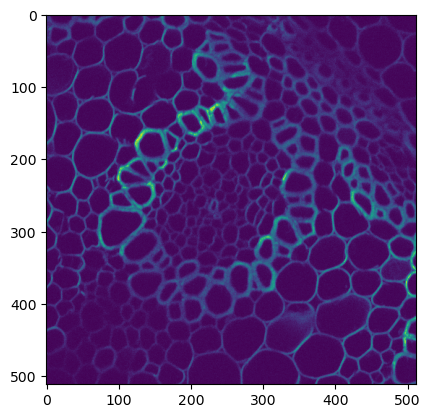

In [4]:
plt.imshow(data[0])
print(data.shape)
data[0].max()

In [4]:
def psnrToString(inp):
    if inp < 0:
        return 'm'+str(-inp)
    else:
        return str(inp)

# we set the pseudo PSNR range used for splitting the images into input and target
minpsnr = -40
maxpsnr = -5

name = psnrToString(minpsnr)+"to"+psnrToString(maxpsnr)+"-256x256-epsilon"
CHECKPOINT_PATH = '/mnt/c/Users/ankit/Desktop/Msc AIML/Data/checkpoints/models/'


In [6]:
name

'm40tom5-256x256-epsilon'

In [7]:
maxepochs = 25 # train longer for better results

# Create pytorch dataset
dataset = BinomDataset(data[:round(data.shape[0]*0.9)], 256, minpsnr, maxpsnr, virtSize = 500*32)
val_dataset = BinomDataset(data[round(data.shape[0]*0.9):], 256, minpsnr, maxpsnr)

# Create pytorch dataloader for training and validation sets
train_loader = dt.DataLoader(dataset, batch_size=16, shuffle=True, drop_last=True, pin_memory=False, num_workers=4) ## Changing the batch size from 32 to 16 to fit inside the gpu
val_loader = dt.DataLoader(val_dataset, batch_size=16, shuffle=False, drop_last=True,  pin_memory=False, num_workers=4)

img =  next(iter(val_loader))

print(img.shape)


trainer = pl.Trainer(default_root_dir=os.path.join(CHECKPOINT_PATH, name), gradient_clip_val=0.5,
                     accelerator = 'gpu',
                     max_epochs=maxepochs, 
                     callbacks=[ModelCheckpoint(save_weights_only=True, mode="min", monitor="val_loss"),
                                LearningRateMonitor("epoch"),
                                EarlyStopping('val_loss', patience=2000)])

model = UN(channels = 1, levels=10, depth=6,
                 start_filts=28, up_mode = 'upsample', merge_mode = 'concat').to(device)

torch.Size([16, 2, 256, 256])


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


In [8]:
trainer.fit(model, train_loader, val_loader)
trainer.save_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt')

Missing logger folder: /mnt/c/Users/ankit/Desktop/Msc AIML/Data/checkpoints/models/m40tom5-256x256-epsilon/lightning_logs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name       | Type       | Params | Mode 
--------------------------------------------------
0 | conv_final | Conv2d     | 29     | train
1 | down_convs | ModuleList | 24.1 M | train
2 | up_convs   | ModuleList | 10.2 M | train
--------------------------------------------------
34.2 M    Trainable params
0         Non-trainable params
34.2 M    Total params
136.982   Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_epochs=25` reached.


# Denoising

In [5]:
model = UN.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

In [10]:
os.path.join(CHECKPOINT_PATH, name)

'/mnt/c/Users/ankit/Desktop/Msc AIML/Data/checkpoints/models/m40tom5-256x256-epsilon'

In [6]:
# import tensorboard

In [8]:
# tensorboard --logdir='/mnt/c/Users/ankit/Desktop/Msc AIML/Data/checkpoints/models/m40tom5-256x256/lightning_logs'

SyntaxError: cannot assign to operator (1244522463.py, line 1)

/mnt/c/Users/ankit/Desktop/Msc AIML/msc-project/GAP

In [6]:
dataTest = imread('/mnt/c/Users/ankit/Desktop/Msc AIML/Data/convallaria/testData.tif')[:1]     # to speed things up, we are only doing the first image
dataTestGT =imread('/mnt/c/Users/ankit/Desktop/Msc AIML/Data/convallaria/testDataGT.tif')[:1]
dataTest.shape

(1, 512, 512)

332 0 44.3373404001294 272.0 17.0


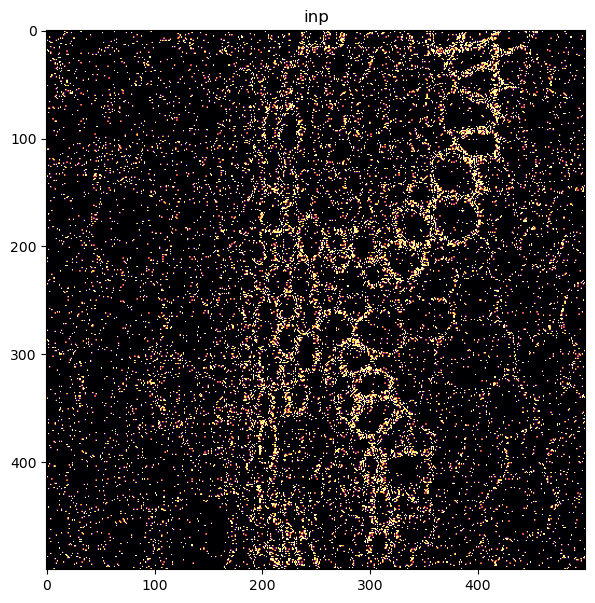

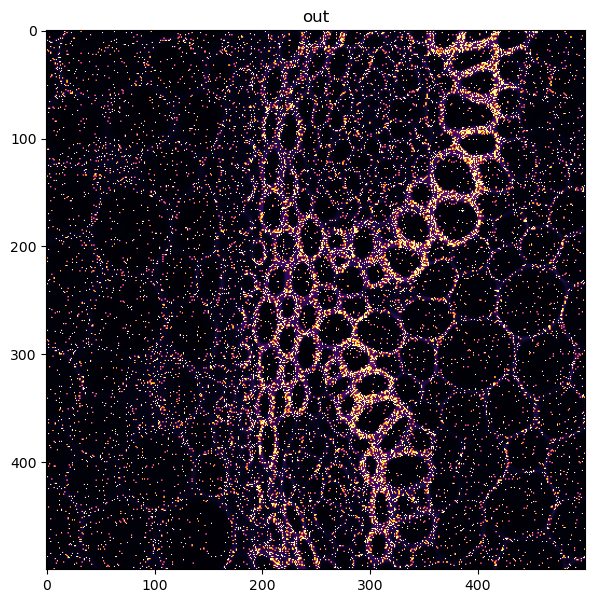

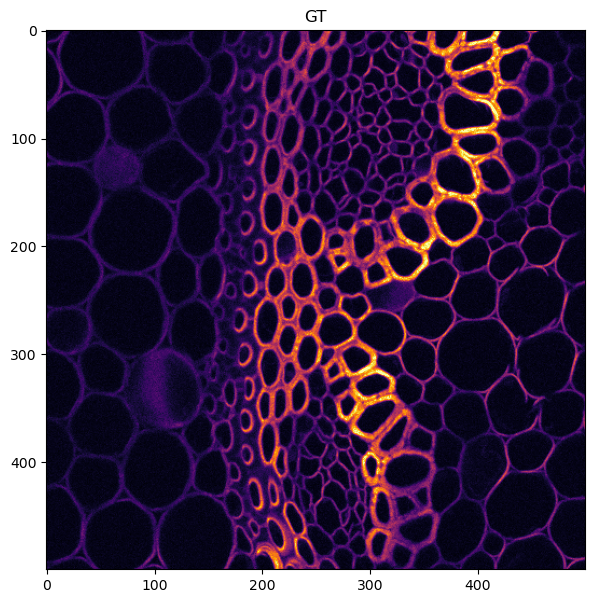

In [37]:
outputs = []
for inp, gt in zip(dataTest, dataTestGT):  
    inpT = torch.from_numpy(inp.astype(np.float32)).to(device)
    # We have to apply softmax over pixels
    out = torch.exp(model(inpT[None,None,...]).detach().cpu())
    # out = inp.sum() * out / out.sum() ## multiply noisy image with probability distribution of clean image?
    outputs.append(out.numpy()[0,0])
    
    print(gt.max(), gt.min(), gt.std(), np.percentile(gt,99.9), np.percentile(gt,50))
    
    # inp = inp/inp.mean()
    # out = out/out.mean()
    gt = gt/gt.mean()
    vmax = np.percentile(gt,99.9)
    
    plt.figure(figsize=(7,7))
    plt.imshow(inp[:500,:500]/inp[:500,:500].mean(),vmin = 0, vmax = vmax, cmap = "inferno")
    plt.title('inp')
    plt.show()
    
    plt.figure(figsize=(7,7))
    plt.imshow(out[0,0][:500,:500]/out[0,0][:500,:500].mean(),vmin = 0,vmax = vmax, cmap = "inferno")
    plt.title('out')
    plt.show()
    
    plt.figure(figsize=(7,7))
    plt.imshow(gt[:500,:500],vmin = 0,vmax = vmax, cmap = "inferno")
    plt.title('GT')
    plt.show()


332 0 44.3373404001294 272.0 17.0


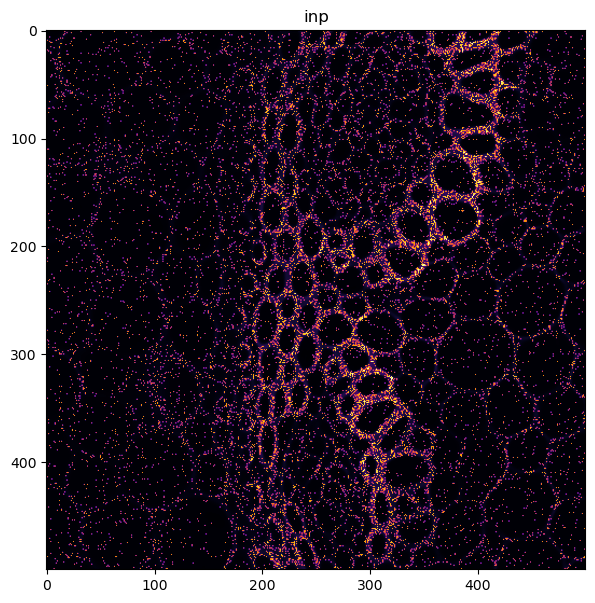

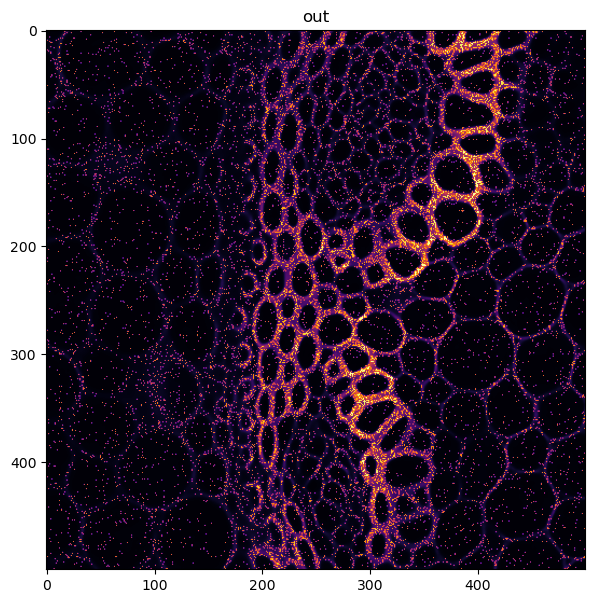

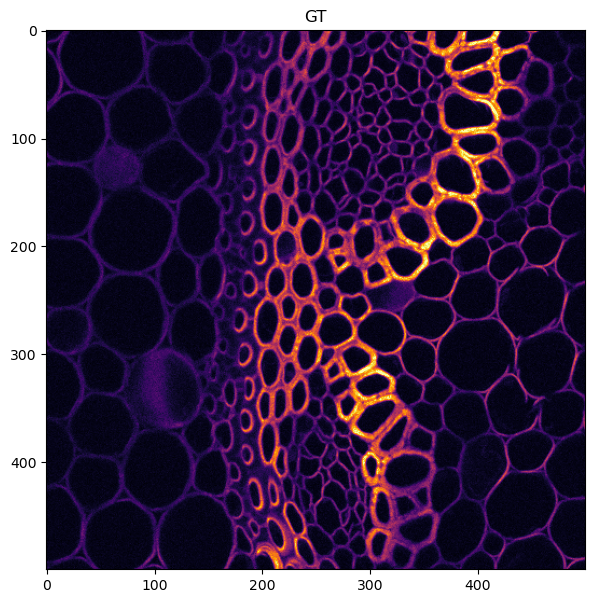

332 0 44.3373404001294 272.0 17.0


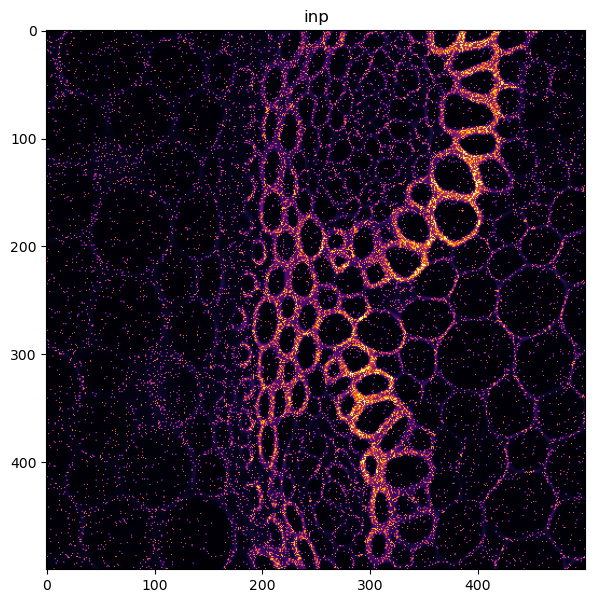

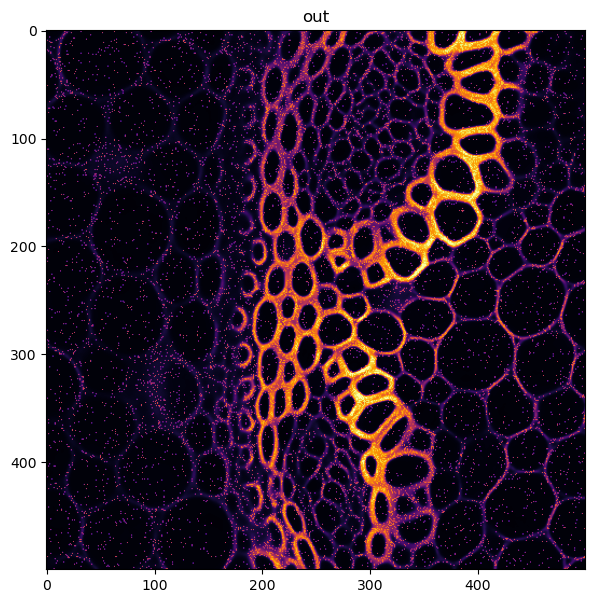

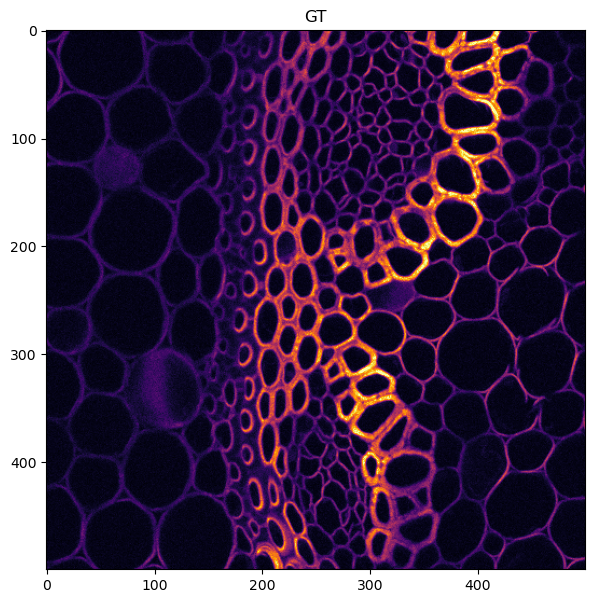

332 0 44.3373404001294 272.0 17.0


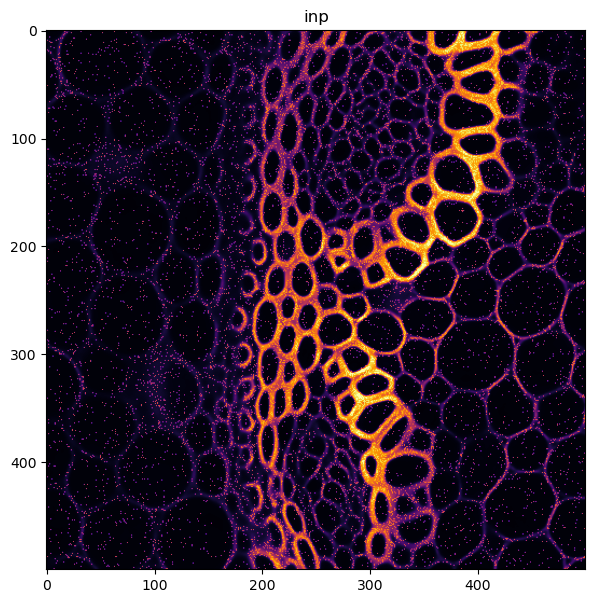

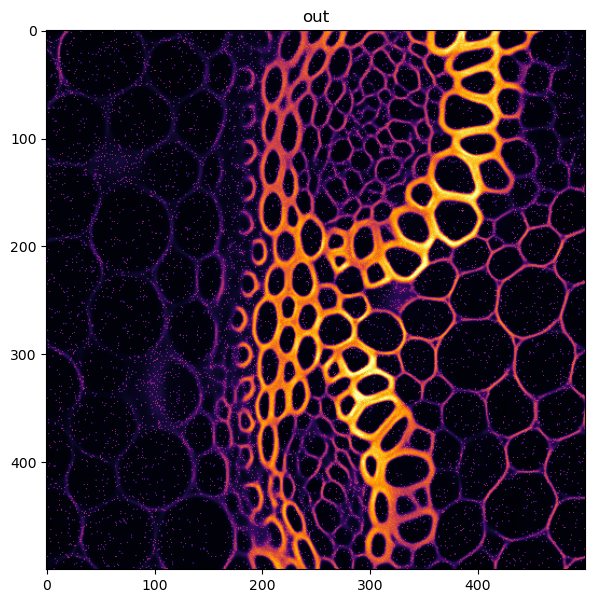

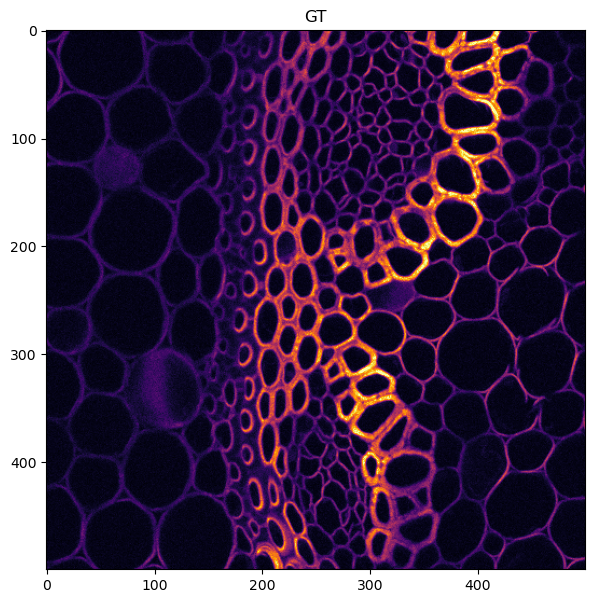

332 0 44.3373404001294 272.0 17.0


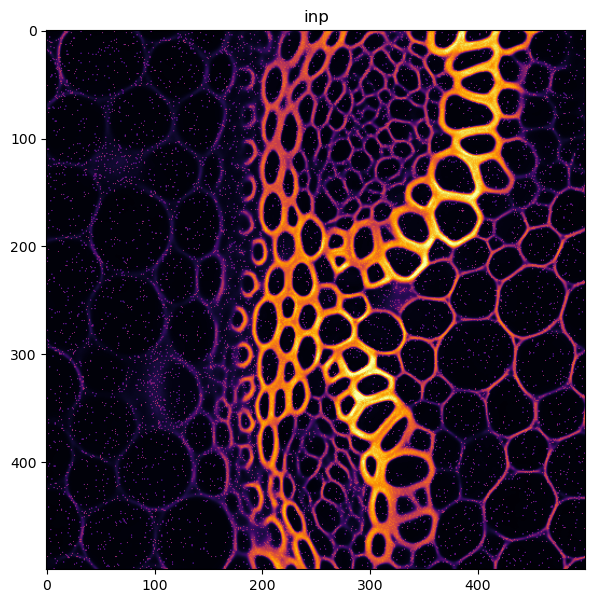

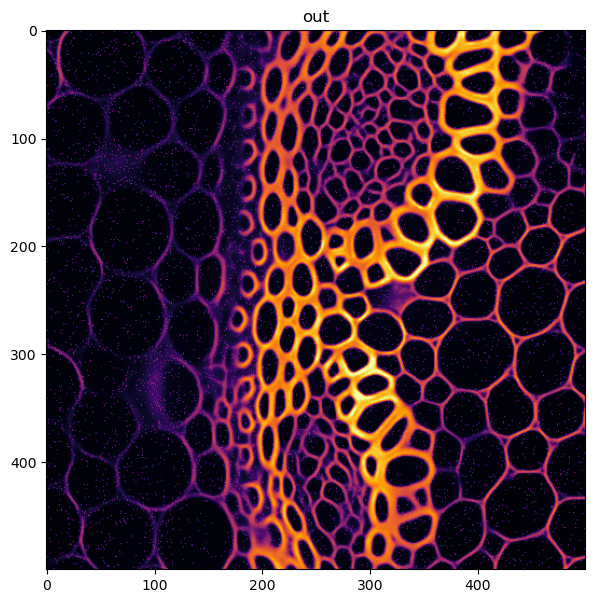

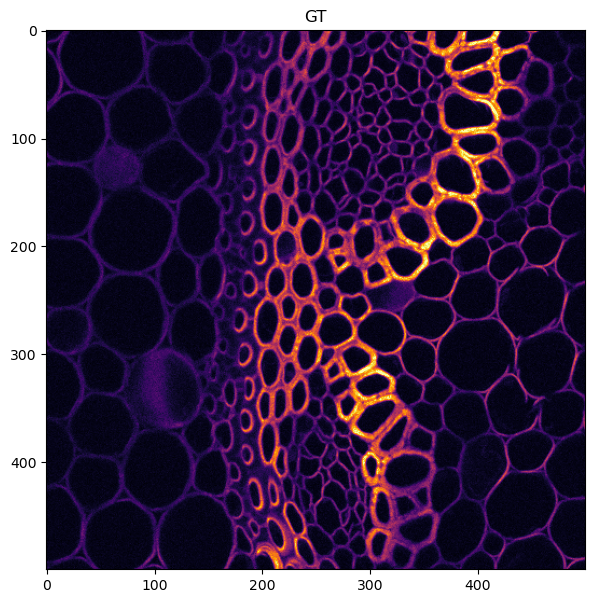

332 0 44.3373404001294 272.0 17.0


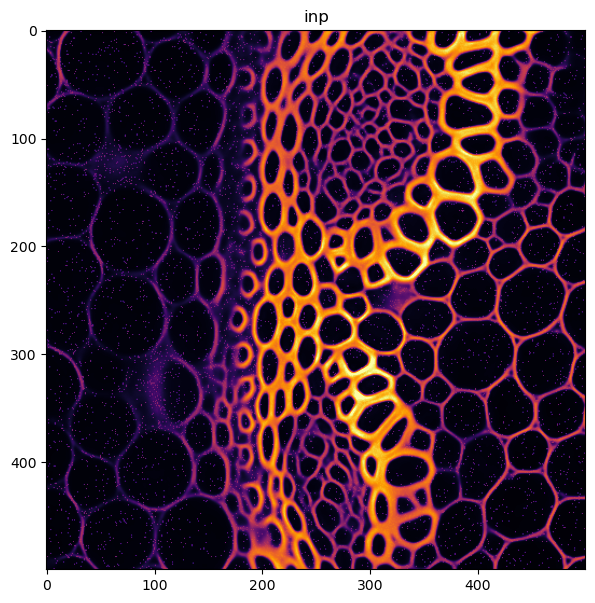

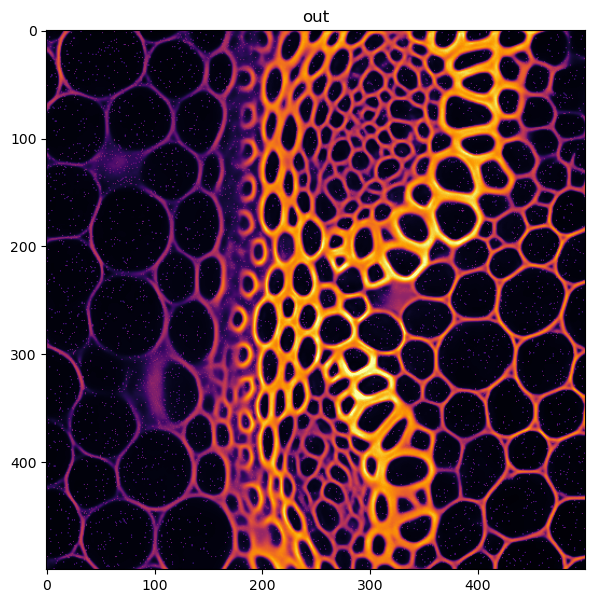

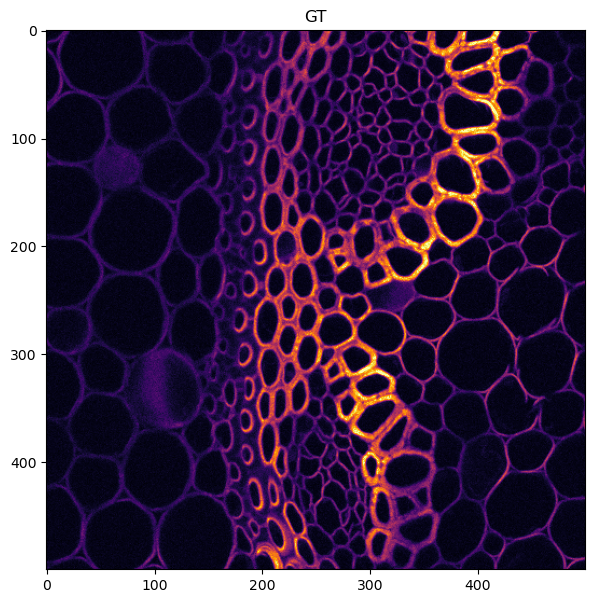

332 0 44.3373404001294 272.0 17.0


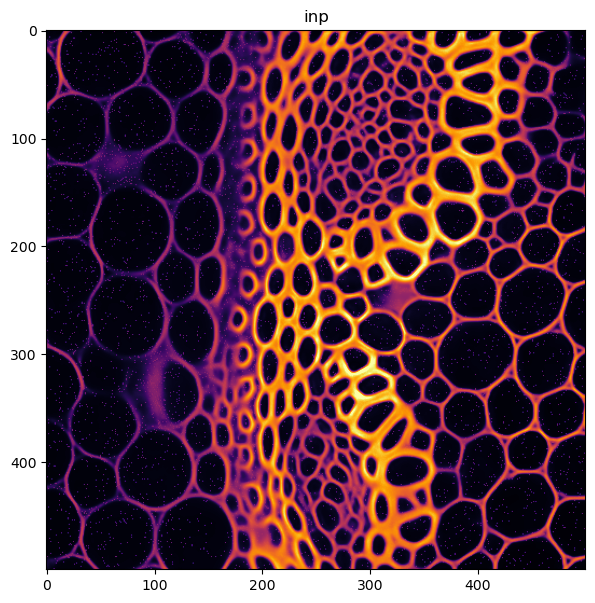

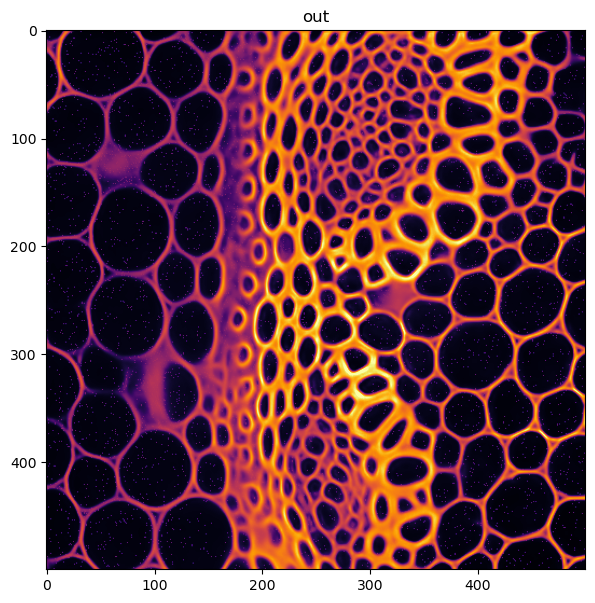

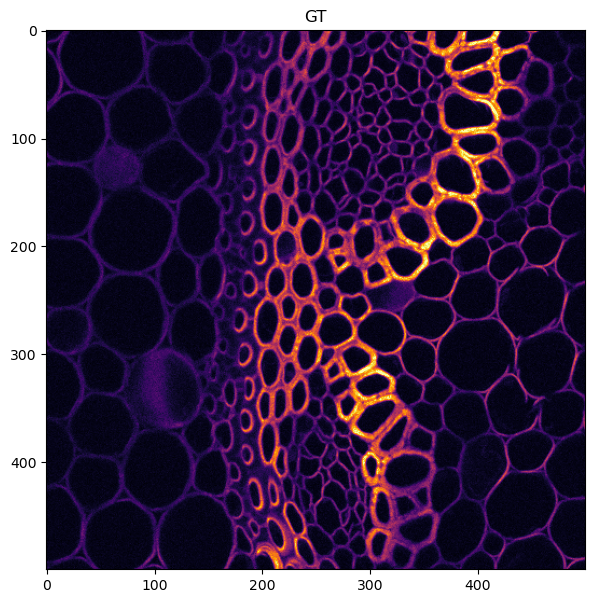

332 0 44.3373404001294 272.0 17.0


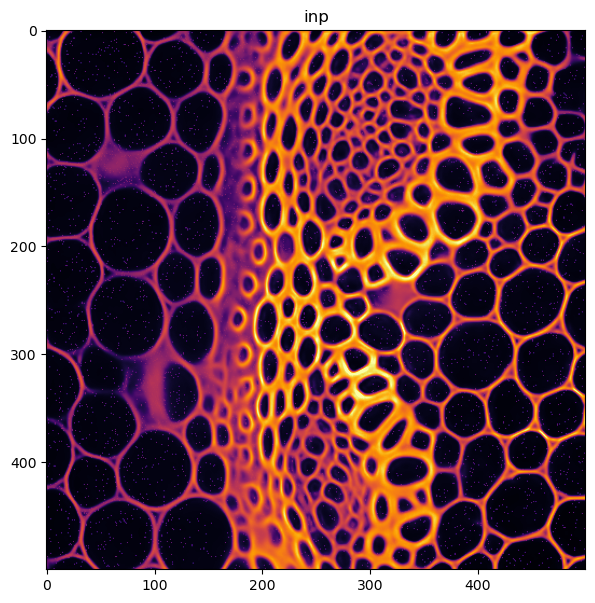

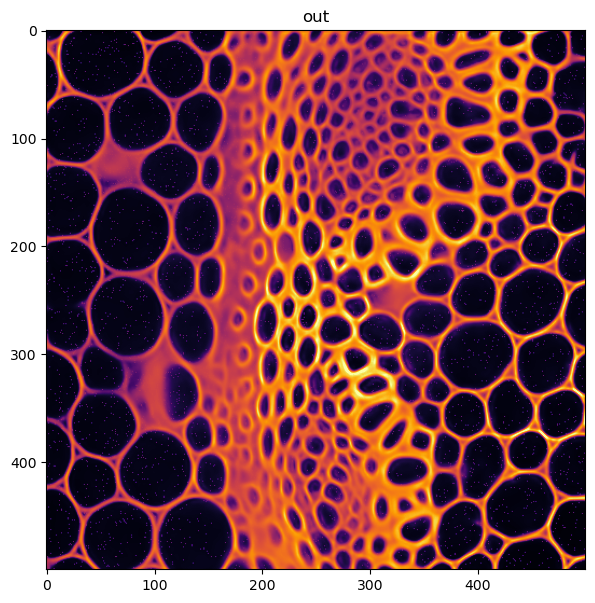

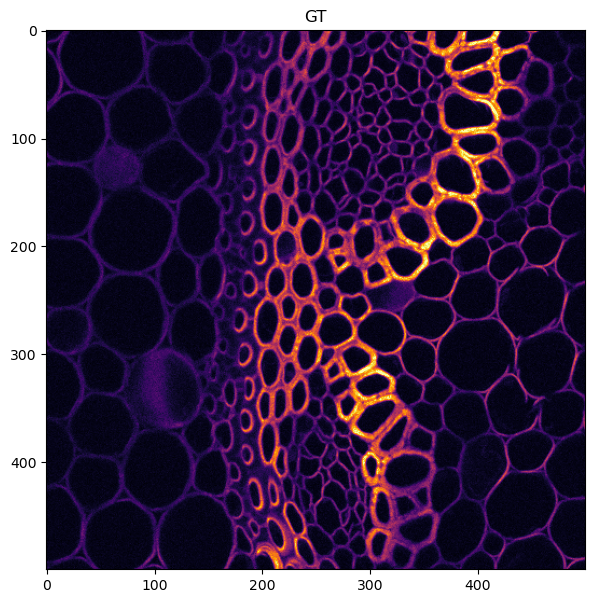

332 0 44.3373404001294 272.0 17.0


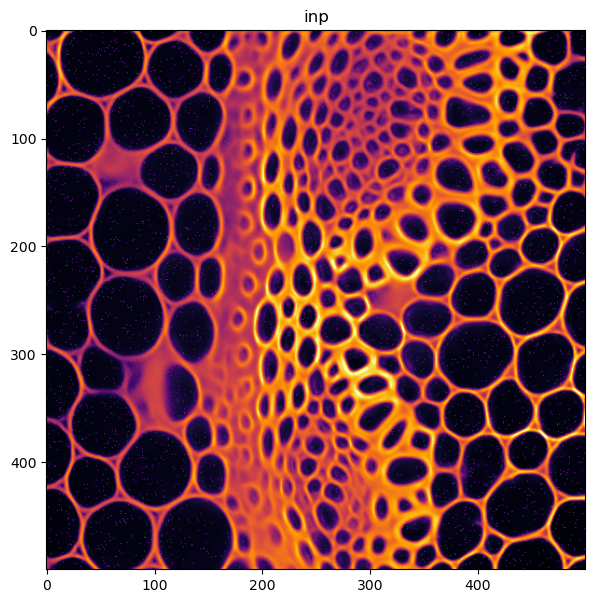

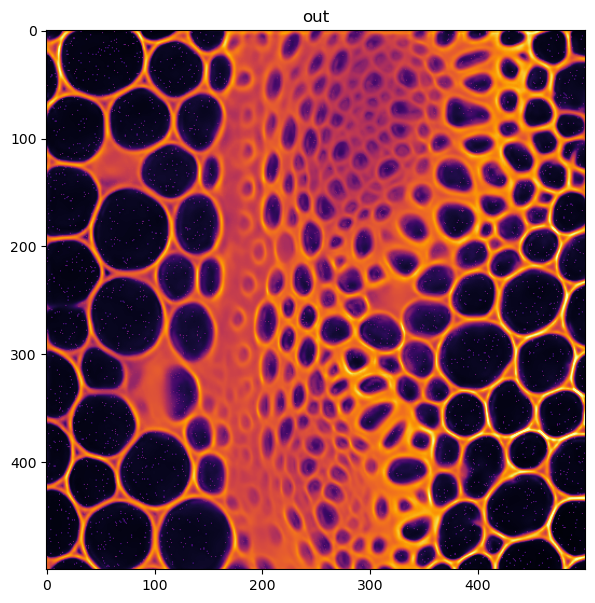

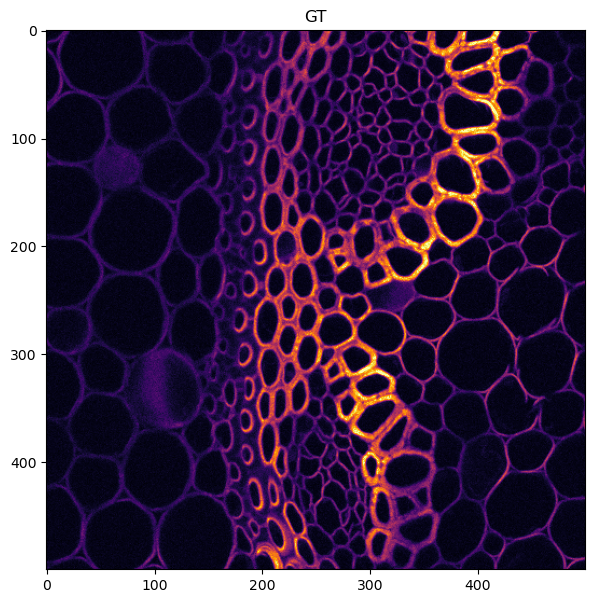

332 0 44.3373404001294 272.0 17.0


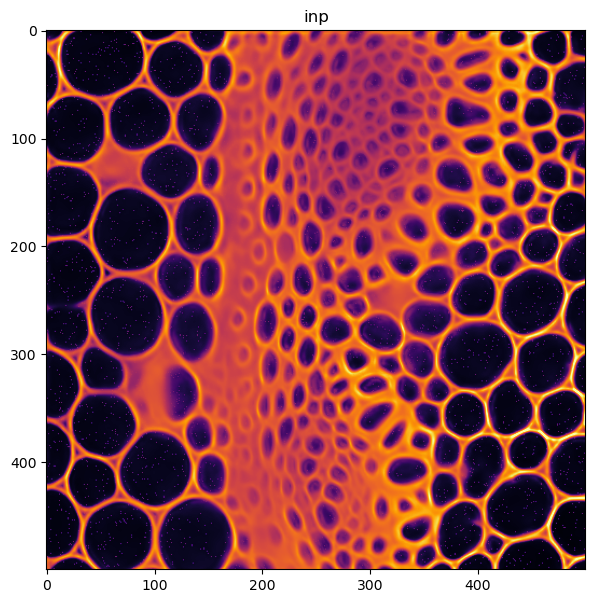

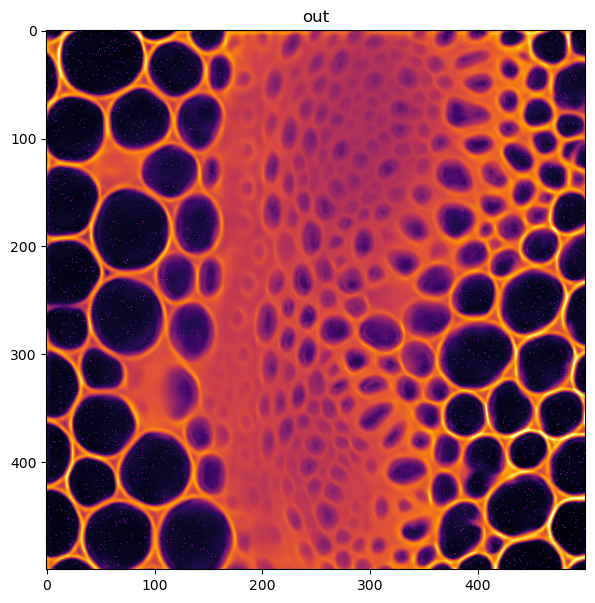

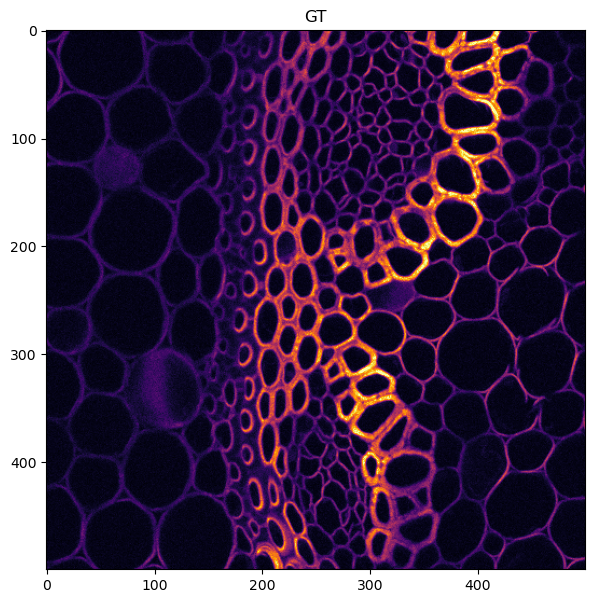

332 0 44.3373404001294 272.0 17.0


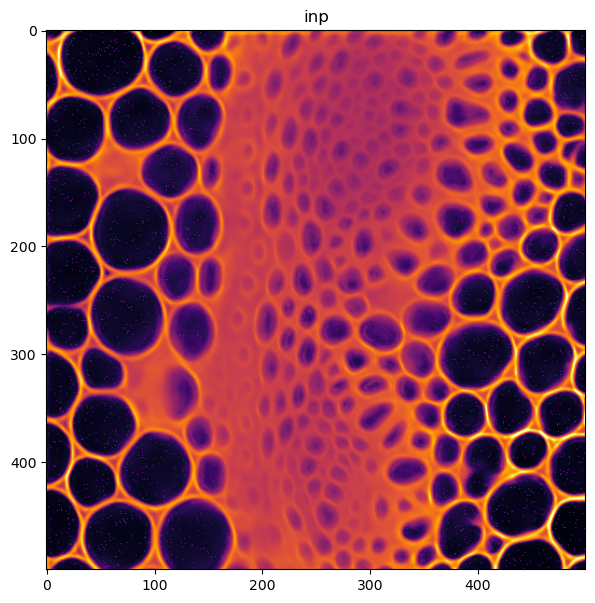

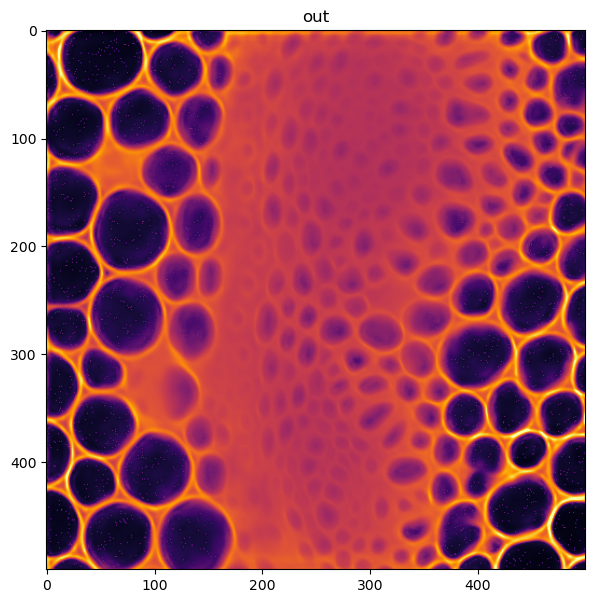

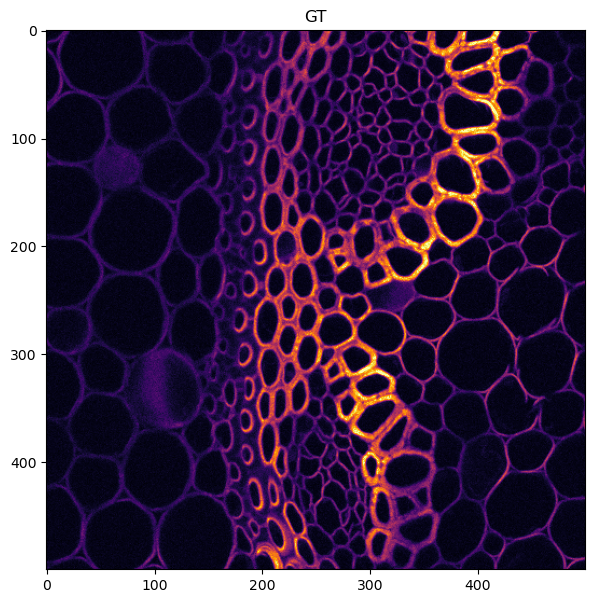

In [38]:
outputs = []
for i in range(10):
    for inp, gt in zip(dataTest, dataTestGT):  
        inpT = (out).to(device)
        # We have to apply softmax over pixels
        out = torch.exp(model(inpT).detach().cpu())
        # out = inp.sum() * out / out.sum() ## multiply noisy image with probability distribution of clean image?
        outputs.append(out.numpy()[0,0])
        
        print(gt.max(), gt.min(), gt.std(), np.percentile(gt,99.9), np.percentile(gt,50))
        
        # inp = inp/inp.mean()
        # out = out/out.mean()
        gt = gt/gt.mean()
        vmax = np.percentile(inpT[0,0][:500,:500].detach().cpu()/inpT[0,0][:500,:500].detach().cpu().mean(),99.9)
        
        plt.figure(figsize=(7,7))
        plt.imshow(inpT[0,0][:500,:500].detach().cpu()/inpT[0,0][:500,:500].detach().cpu().mean(),vmin = 0, vmax = vmax, cmap = "inferno")
        plt.title('inp')
        plt.show()
        vmax = np.percentile(out[0,0][:500,:500]/out[0,0][:500,:500].mean(),99.9)
        plt.figure(figsize=(7,7))
        plt.imshow(out[0,0][:500,:500]/out[0,0][:500,:500].mean(),vmin = 0,vmax = vmax, cmap = "inferno")
        plt.title('out')
        plt.show()
        vmax = np.percentile(gt[:500,:500]/gt[:500,:500].mean(),99.9)      
        plt.figure(figsize=(7,7))
        plt.imshow(gt[:500,:500]/gt[:500,:500].mean(),vmin = 0,vmax = vmax, cmap = "inferno")
        plt.title('GT')
        plt.show()


In [11]:
out.min(), inp.min(), gt.min(), out.max(), inp.max(), gt.max()

(tensor(0.1833),
 0.0,
 0.0,
 tensor(8.2268),
 56.50873032981246,
 9.088920968132209)

In [12]:
out.sum()

tensor(262143.9844)

In [15]:
outputs = np.array(outputs)
imsave('/mnt/c/Users/ankit/Desktop/Msc AIML/Data/convallaria/output.tif',outputs, imagej = True)

# Sampling images

torch.Size([1, 1, 256, 256])
torch.Size([1, 1, 256, 256])
torch.Size([1, 1, 256, 256])
torch.Size([1, 1, 256, 256])
torch.Size([1, 1, 256, 256])
torch.Size([1, 1, 256, 256])


torch.Size([1, 1, 256, 256])
torch.Size([1, 1, 256, 256])
torch.Size([1, 1, 256, 256])
torch.Size([1, 1, 256, 256])
torch.Size([1, 1, 256, 256])
torch.Size([1, 1, 256, 256])
torch.Size([1, 1, 256, 256])
torch.Size([1, 1, 256, 256])
torch.Size([1, 1, 256, 256])
torch.Size([1, 1, 256, 256])
torch.Size([1, 1, 256, 256])
torch.Size([1, 1, 256, 256])
torch.Size([1, 1, 256, 256])
torch.Size([1, 1, 256, 256])
torch.Size([1, 1, 256, 256])
torch.Size([1, 1, 256, 256])
torch.Size([1, 1, 256, 256])
torch.Size([1, 1, 256, 256])
torch.Size([1, 1, 256, 256])
torch.Size([1, 1, 256, 256])
torch.Size([1, 1, 256, 256])
torch.Size([1, 1, 256, 256])
torch.Size([1, 1, 256, 256])
torch.Size([1, 1, 256, 256])
torch.Size([1, 1, 256, 256])
torch.Size([1, 1, 256, 256])
torch.Size([1, 1, 256, 256])
torch.Size([1, 1, 256, 256])
torch.Size([1, 1, 256, 256])
torch.Size([1, 1, 256, 256])
torch.Size([1, 1, 256, 256])
torch.Size([1, 1, 256, 256])
torch.Size([1, 1, 256, 256])
torch.Size([1, 1, 256, 256])
torch.Size([1,

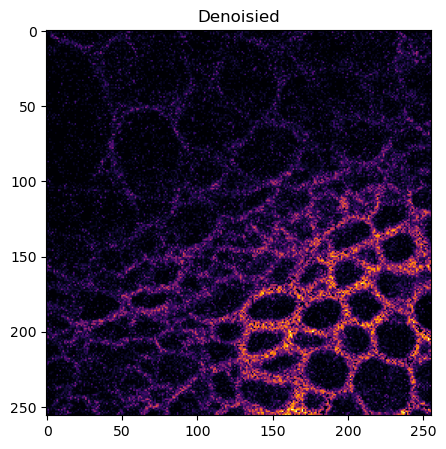

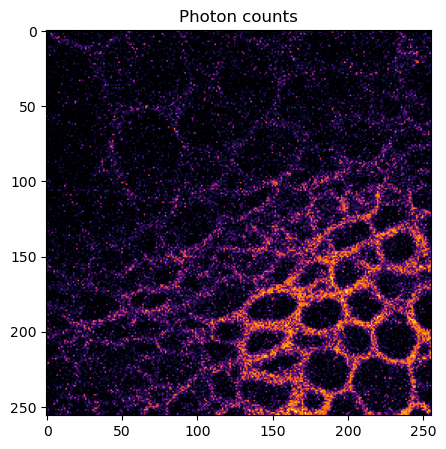

_______________________________________ 26
time (s): 1.3397979736328125 time per image (s) 1.3397979736328125


In [12]:
import matplotlib.image as mpimg
import time
import numpy as np

# We are starting with an image containing zeros,
# i.e., sampling from scratch

# we just have 1 channel
channels = 1
# we can sample multiple images at the same time in a batch
batch_size = 1
# for best results this should correspond to training pach size
pixels_x = 256
pixels_y = 256

inp_img =  torch.zeros(batch_size ,channels, pixels_y, pixels_x).to(device)


for i in range(1):
    

    startTime = time.time()
    
    # sampling the image(s)
    denoised, photons, stack, iterations = sample_image(inp_img,
                                                        model, 
                                                        beta = 1,
                                                        save_every_n = 2,
                                                        max_psnr = 5)

    
    # In case we do multiple images in a batch, we show all of them.
    for j in range(denoised.shape[0]):
#         print(iterations)

            print(denoised.shape)
            plt.figure(figsize = (5,5))
            plt.imshow(denoised[j,0], cmap='inferno', vmin = 0,
                       vmax = np.percentile(denoised[j],99.99))
            plt.title('Denoisied')
            plt.show()
            
            plt.figure(figsize = (5,5))
            plt.imshow(photons[j,0], cmap='inferno', vmin = 0,
                       vmax = np.percentile(photons[j],99.99))
            plt.title('Photon counts')
            plt.show()
            
            
    
    print('_______________________________________', iterations)
    
    
    
    
    endTime = time.time()
    elapsedTime = endTime - startTime
    print ('time (s):', elapsedTime, 'time per image (s)', elapsedTime/denoised.shape[0])
   

## Looking at the intermediate outputs

0


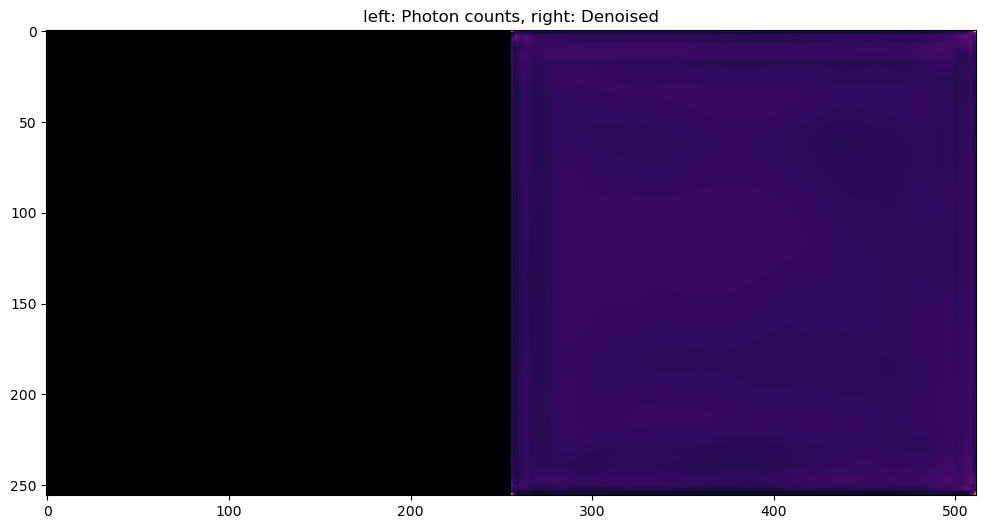

1


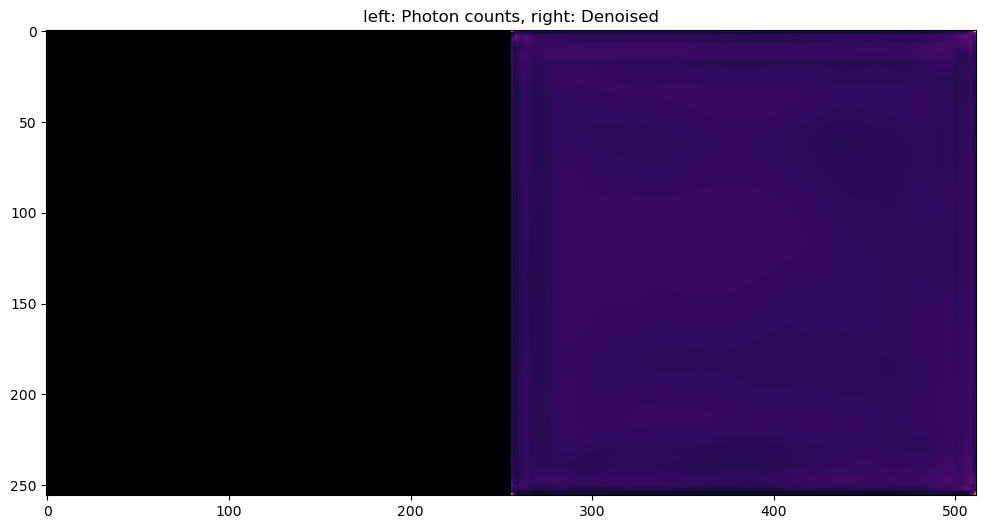

2


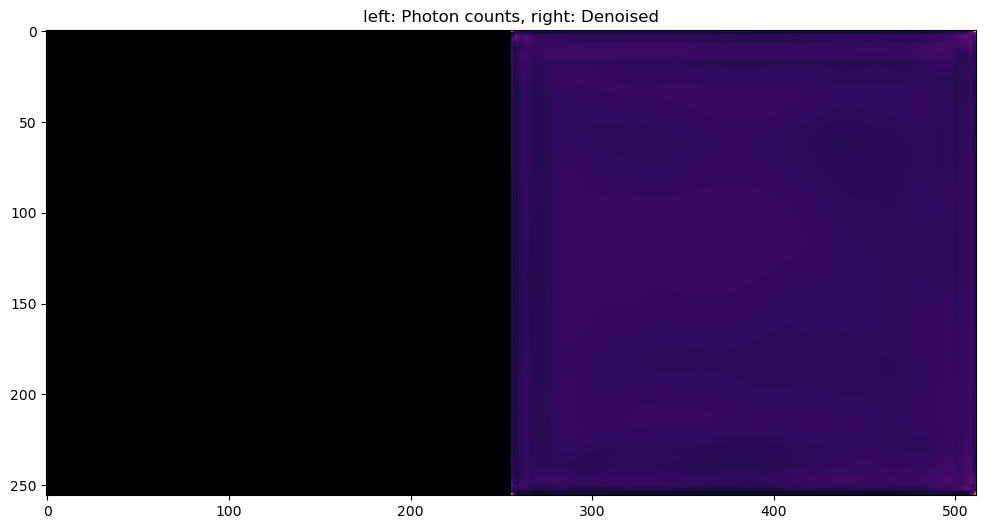

3


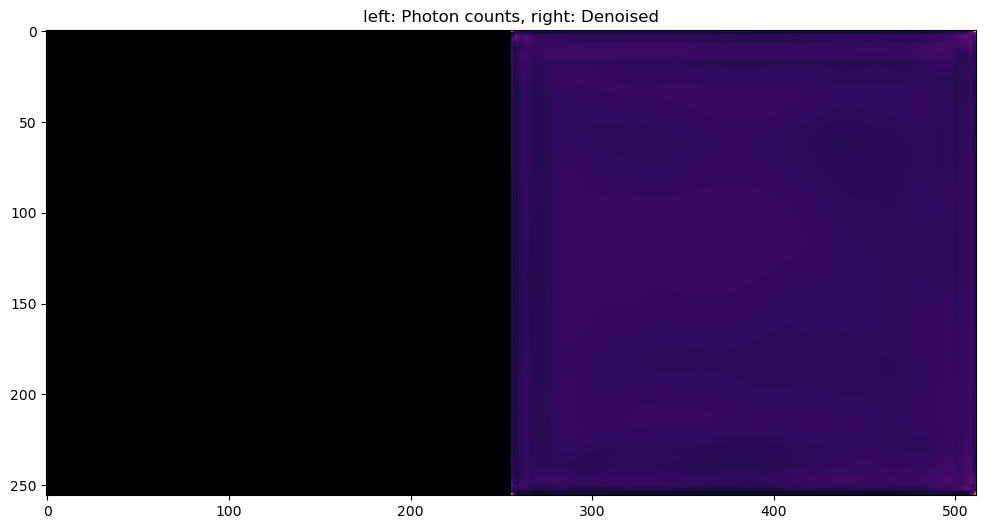

4


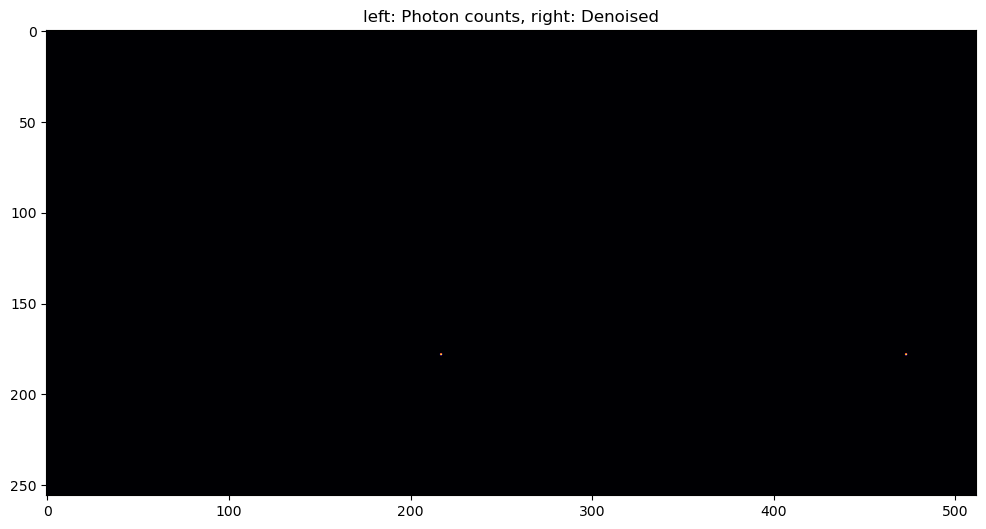

5


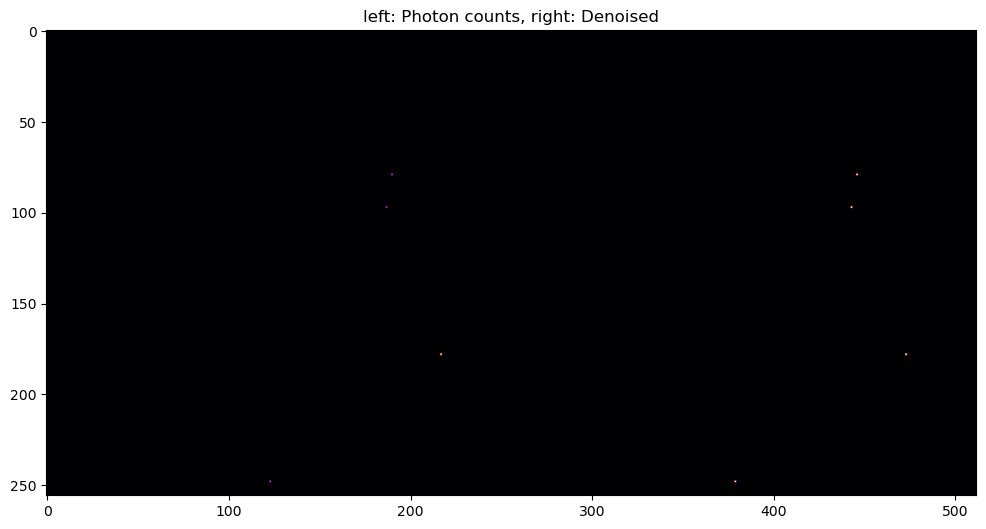

6


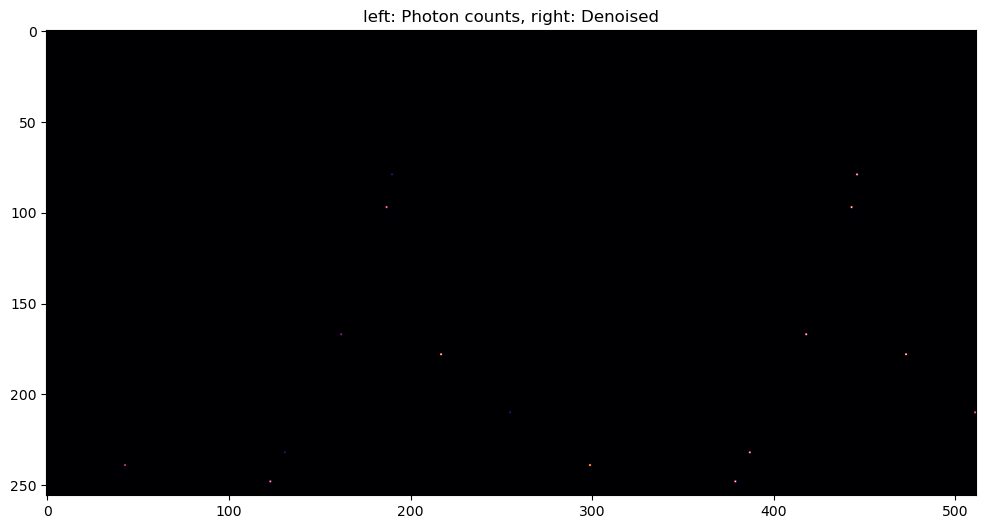

7


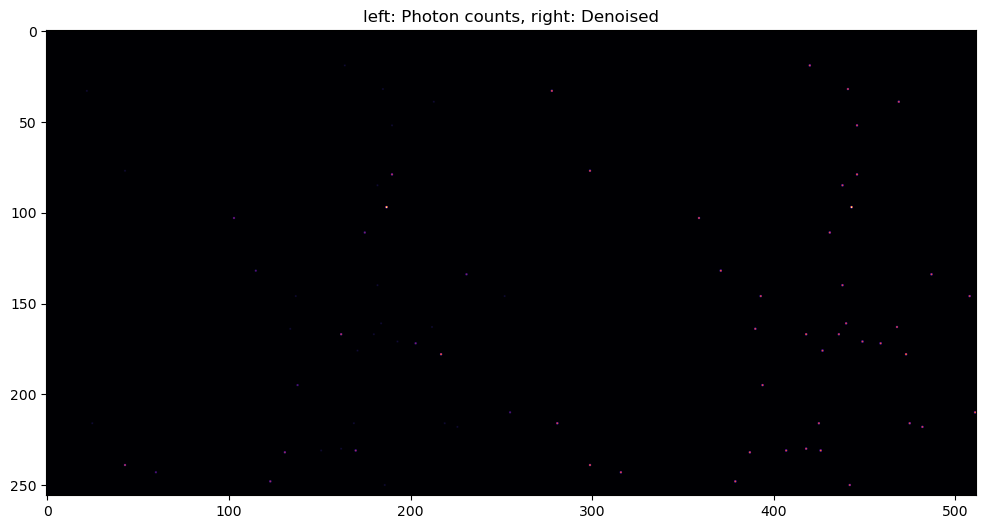

8


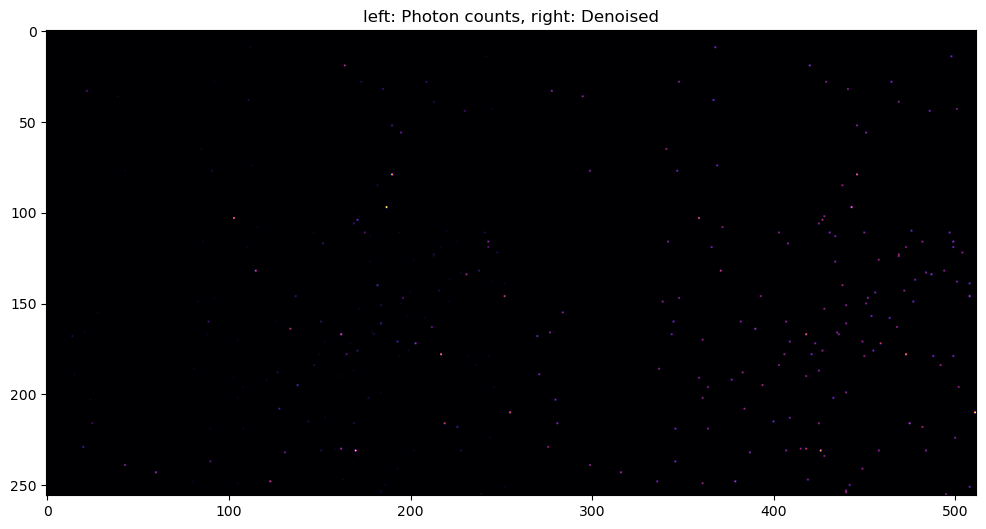

9


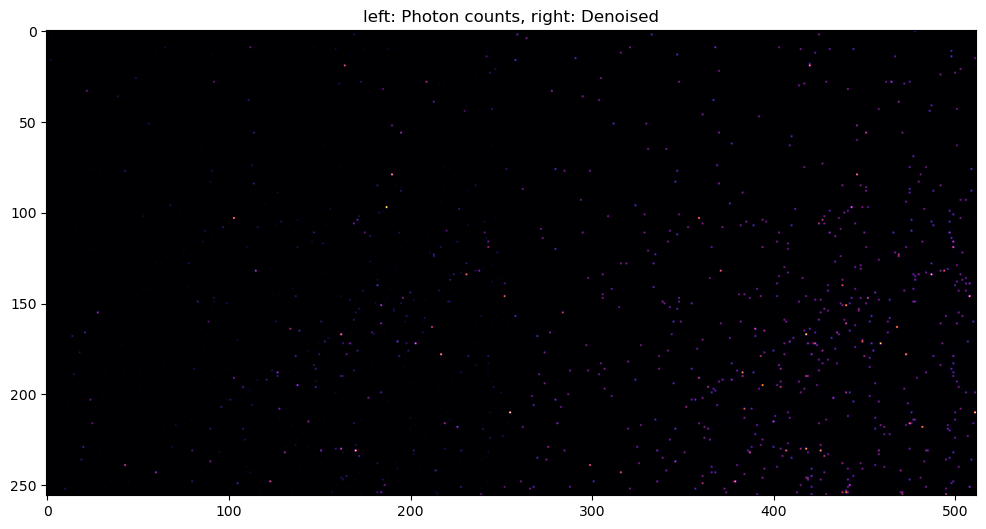

10


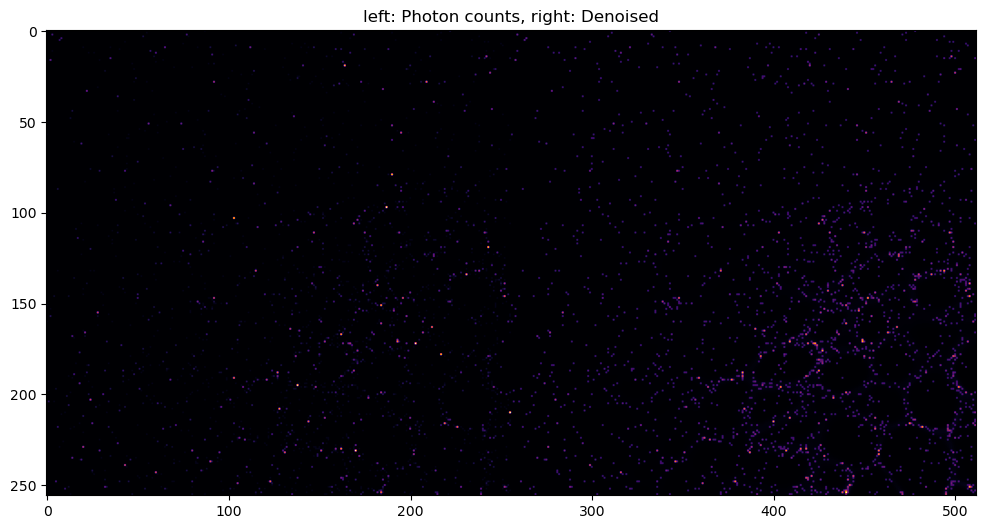

11


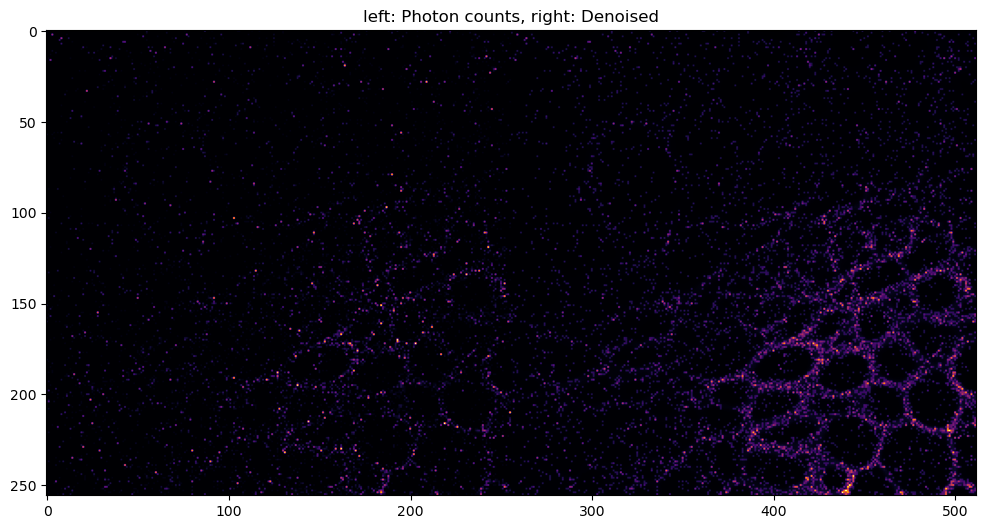

12


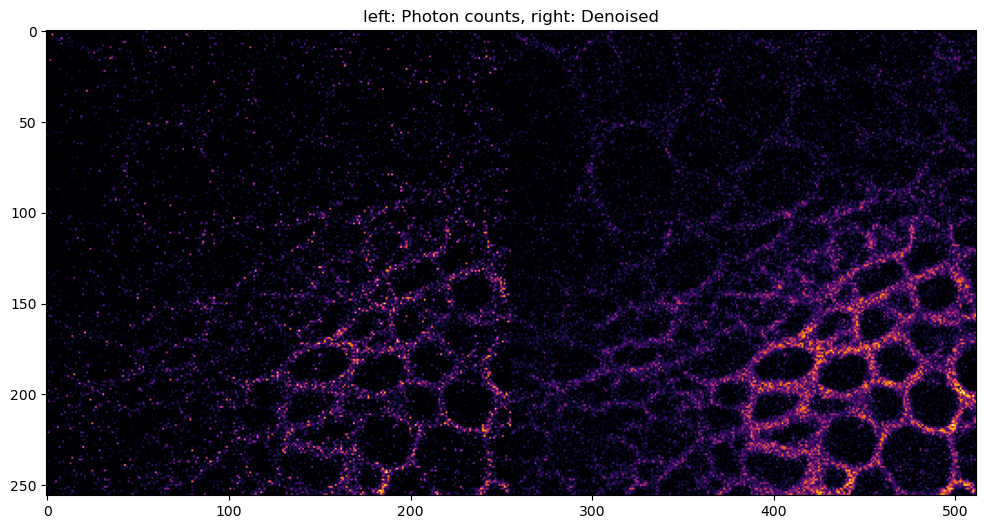

In [13]:
stack[0].shape
for i in range(len(stack)):
    im = stack[i]
    print(i)
    plt.figure(figsize = (12,12))
    plt.imshow(im,cmap ='inferno', vmax = 0.9)
    plt.title('left: Photon counts, right: Denoised')
    plt.show()

In [2]:
model = UN(channels = 1, levels=10, depth=6,
                 start_filts=28, up_mode = 'upsample', merge_mode = 'concat').to(device)

In [3]:
print(model)

UN(
  (conv_final): Conv2d(28, 1, kernel_size=(1, 1), stride=(1, 1))
  (down_convs): ModuleList(
    (0): DownConv(
      (conv1): Conv2d(10, 28, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (conv2): Conv2d(28, 28, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (conv3): Conv2d(28, 28, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    )
    (1): DownConv(
      (conv1): Conv2d(28, 56, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (conv2): Conv2d(56, 56, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (conv3): Conv2d(56, 56, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    )
    (2): DownConv(
      (conv1): Conv2d(56, 112, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (conv2): Conv2d(112, 112, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
     

In [10]:
from torchsummary import summary
summary(model.cuda(), input_size = (1, 256, 256), batch_size=1)

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1          [1, 28, 256, 256]           2,548
            Conv2d-2          [1, 28, 256, 256]           7,084
            Conv2d-3          [1, 28, 256, 256]           7,084
         MaxPool2d-4          [1, 28, 128, 128]               0
          DownConv-5  [[-1, 28, 128, 128], [-1, 28, 256, 256]]               0
            Conv2d-6          [1, 56, 128, 128]          14,168
            Conv2d-7          [1, 56, 128, 128]          28,280
            Conv2d-8          [1, 56, 128, 128]          28,280
         MaxPool2d-9            [1, 56, 64, 64]               0
         DownConv-10  [[-1, 56, 64, 64], [-1, 56, 128, 128]]               0
           Conv2d-11           [1, 112, 64, 64]          56,560
           Conv2d-12           [1, 112, 64, 64]         113,008
           Conv2d-13           [1, 112, 64, 64]         113,008
        Max

In [12]:
model.parameters

<bound method Module.parameters of UN(
  (conv_final): Conv2d(28, 1, kernel_size=(1, 1), stride=(1, 1))
  (down_convs): ModuleList(
    (0): DownConv(
      (conv1): Conv2d(10, 28, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (conv2): Conv2d(28, 28, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (conv3): Conv2d(28, 28, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    )
    (1): DownConv(
      (conv1): Conv2d(28, 56, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (conv2): Conv2d(56, 56, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (conv3): Conv2d(56, 56, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    )
    (2): DownConv(
      (conv1): Conv2d(56, 112, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (conv2): Conv2d(112, 112, kernel_size=(3, 3), s

332 0 44.3373404001294 272.0 17.0


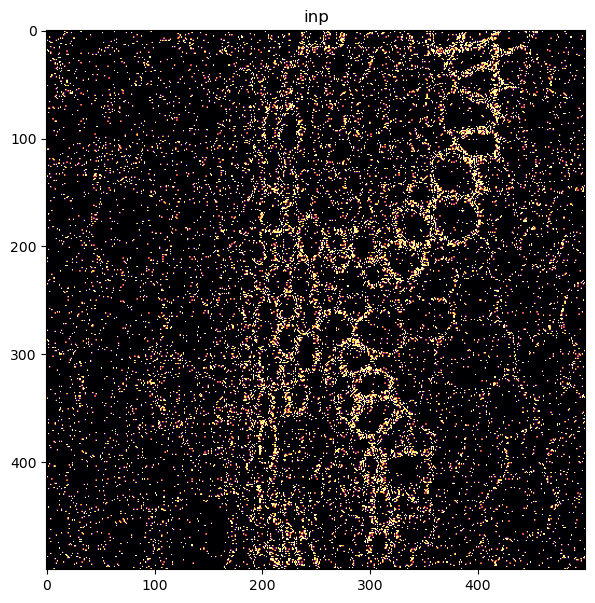

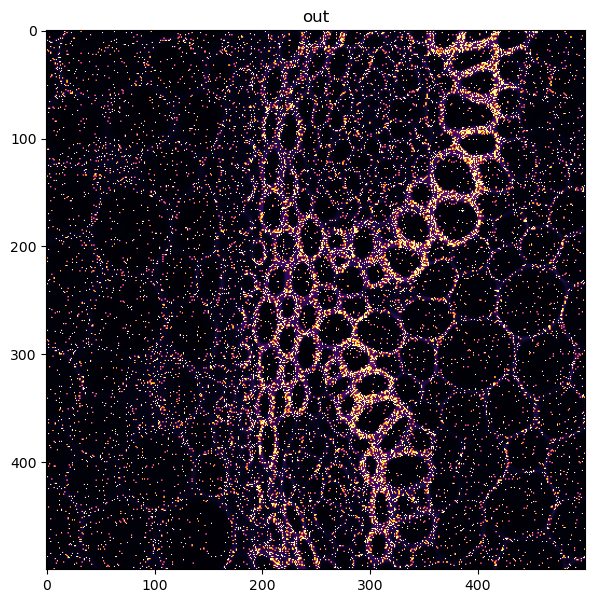

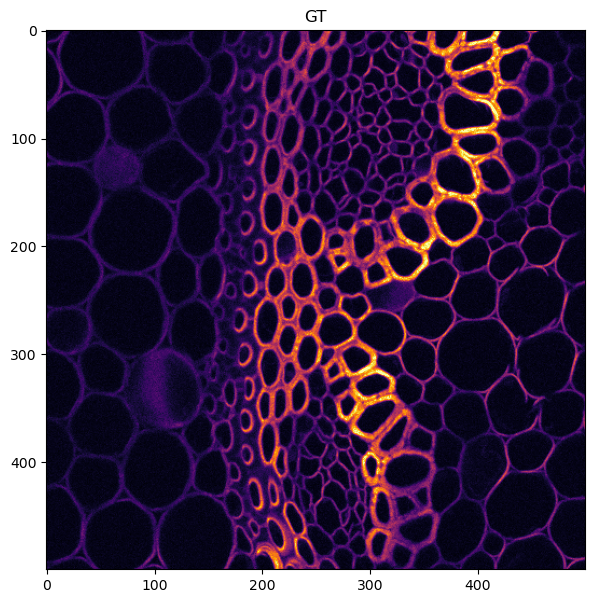

In [60]:
outputs = []
for inp, gt in zip(dataTest, dataTestGT):  
    inpT = torch.from_numpy(inp.astype(np.float32)).to(device)
    # We have to apply softmax over pixels
    out = torch.exp(model(inpT[None,None,...]).detach().cpu())
    # out = inp.sum() * out / out.sum() ## multiply noisy image with probability distribution of clean image?
    outputs.append(out.numpy()[0,0])
    
    print(gt.max(), gt.min(), gt.std(), np.percentile(gt,99.9), np.percentile(gt,50))
    
    # inp = inp/inp.mean()
    # out = out/out.mean()
    gt = gt/gt.mean()
    vmax = np.percentile(gt,99.9)
    
    plt.figure(figsize=(7,7))
    plt.imshow(inp[:500,:500]/inp[:500,:500].mean(),vmin = 0, vmax = vmax, cmap = "inferno")
    plt.title('inp')
    plt.show()
    
    plt.figure(figsize=(7,7))
    plt.imshow(out[0,0][:500,:500]/out[0,0][:500,:500].mean(),vmin = 0,vmax = vmax, cmap = "inferno")
    plt.title('out')
    plt.show()
    
    plt.figure(figsize=(7,7))
    plt.imshow(gt[:500,:500],vmin = 0,vmax = vmax, cmap = "inferno")
    plt.title('GT')
    plt.show()


332 0 44.3373404001294 272.0 17.0


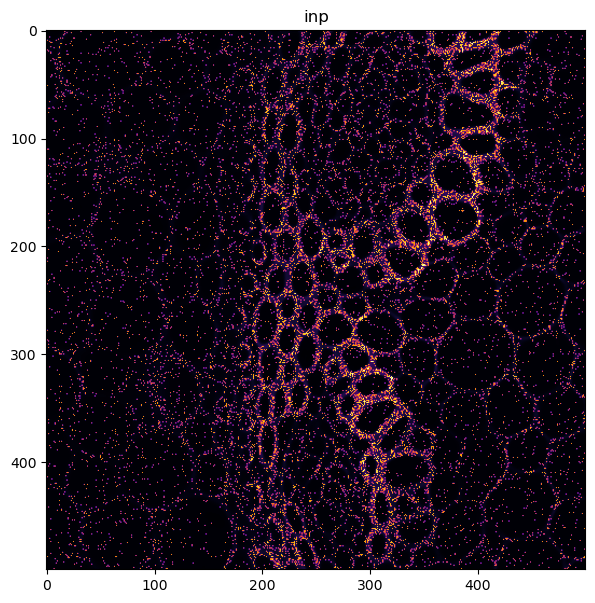

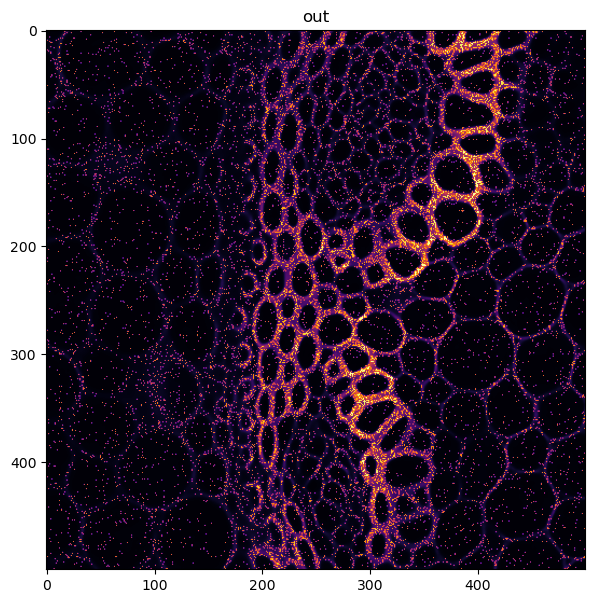

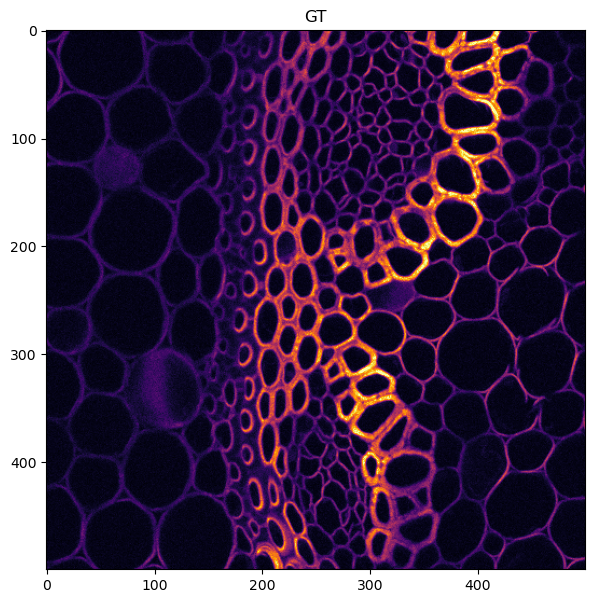

In [61]:
outputs = []
for i in range(1):
    for inp, gt in zip(dataTest, dataTestGT):  
        inpT = (out).to(device)
        # We have to apply softmax over pixels
        out = torch.exp(model(inpT).detach().cpu())
        # out = inp.sum() * out / out.sum() ## multiply noisy image with probability distribution of clean image?
        outputs.append(out.numpy()[0,0])
        
        print(gt.max(), gt.min(), gt.std(), np.percentile(gt,99.9), np.percentile(gt,50))
        
        # inp = inp/inp.mean()
        # out = out/out.mean()
        gt = gt/gt.mean()
        vmax = np.percentile(inpT[0,0][:500,:500].detach().cpu()/inpT[0,0][:500,:500].detach().cpu().mean(),99.9)
        
        plt.figure(figsize=(7,7))
        plt.imshow(inpT[0,0][:500,:500].detach().cpu()/inpT[0,0][:500,:500].detach().cpu().mean(),vmin = 0, vmax = vmax, cmap = "inferno")
        plt.title('inp')
        plt.show()
        vmax = np.percentile(out[0,0][:500,:500]/out[0,0][:500,:500].mean(),99.9)
        plt.figure(figsize=(7,7))
        plt.imshow(out[0,0][:500,:500]/out[0,0][:500,:500].mean(),vmin = 0,vmax = vmax, cmap = "inferno")
        plt.title('out')
        plt.show()
        vmax = np.percentile(gt[:500,:500]/gt[:500,:500].mean(),99.9)      
        plt.figure(figsize=(7,7))
        plt.imshow(gt[:500,:500]/gt[:500,:500].mean(),vmin = 0,vmax = vmax, cmap = "inferno")
        plt.title('GT')
        plt.show()


In [56]:
minpsnr = -40
maxpsnr = -5

name = psnrToString(minpsnr)+"to"+psnrToString(maxpsnr)+"-256x256"
CHECKPOINT_PATH = '/mnt/c/Users/ankit/Desktop/Msc AIML/Data/checkpoints/models/'

In [57]:
from GAP_UNET_ResBlock import UN
from BinomDataset import BinomDataset
from inference import sample_image
gapmodel = UN.load_from_checkpoint(os.path.join(CHECKPOINT_PATH, name)+'.ckpt').to(device)

Lightning automatically upgraded your loaded checkpoint from v1.6.5 to v2.3.2. To apply the upgrade to your files permanently, run `python -m pytorch_lightning.utilities.upgrade_checkpoint ../../../../Data/checkpoints/models/m40tom5-256x256.ckpt`


In [58]:
dataTest = imread('/mnt/c/Users/ankit/Desktop/Msc AIML/Data/convallaria/testData.tif')[:1]     # to speed things up, we are only doing the first image
dataTestGT =imread('/mnt/c/Users/ankit/Desktop/Msc AIML/Data/convallaria/testDataGT.tif')[:1]
dataTest.shape

(1, 512, 512)

332 0 44.3373404001294 272.0 17.0


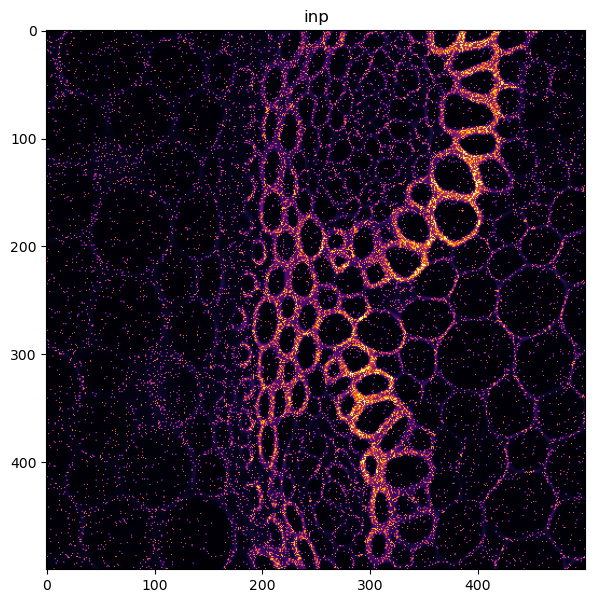

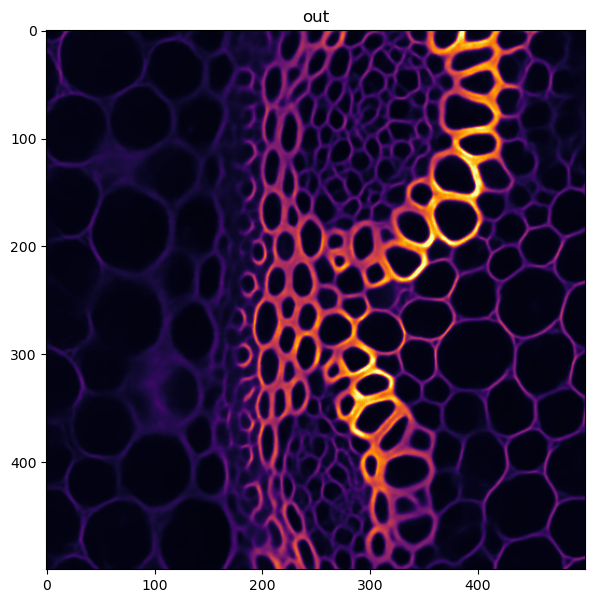

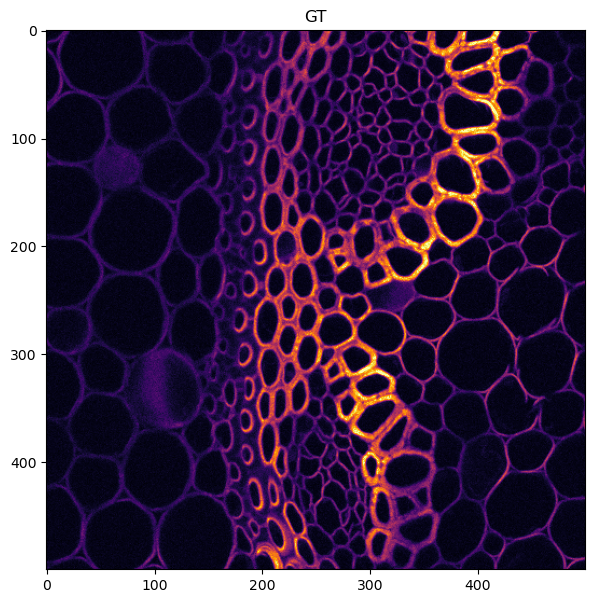

In [62]:
outputs = []
for inp, gt in zip(dataTest, dataTestGT):  
    inpT = (out).to(device)
        # We have to apply softmax over pixels
    out = torch.exp(gapmodel(inpT).detach().cpu())
    out = inp.sum() * out / out.sum() ## multiply noisy image with probability distribution of clean image?
    outputs.append(out.numpy()[0,0])
    
    print(gt.max(), gt.min(), gt.std(), np.percentile(gt,99.9), np.percentile(gt,50))
    
    inp = inp/inp.mean()
    out = out/out.mean()
    gt = gt/gt.mean()
    vmax = np.percentile(gt,99.9)
    
    vmax = np.percentile(inpT[0,0][:500,:500].detach().cpu()/inpT[0,0][:500,:500].detach().cpu().mean(),99.9)
        
    plt.figure(figsize=(7,7))
    plt.imshow(inpT[0,0][:500,:500].detach().cpu()/inpT[0,0][:500,:500].detach().cpu().mean(),vmin = 0, vmax = vmax, cmap = "inferno")
    plt.title('inp')
    plt.show()
    vmax = np.percentile(out[0,0][:500,:500]/out[0,0][:500,:500].mean(),99.9)
    plt.figure(figsize=(7,7))
    plt.imshow(out[0,0][:500,:500]/out[0,0][:500,:500].mean(),vmin = 0,vmax = vmax, cmap = "inferno")
    plt.title('out')
    plt.show()
    vmax = np.percentile(gt[:500,:500]/gt[:500,:500].mean(),99.9)      
    plt.figure(figsize=(7,7))
    plt.imshow(gt[:500,:500]/gt[:500,:500].mean(),vmin = 0,vmax = vmax, cmap = "inferno")
    plt.title('GT')
    plt.show()
